# Kaggle New York City Taxi Trip Duration Prediction

## Libraries

In [1]:
import pandas as pd 
import numpy as np 
import seaborn as sns
import matplotlib.pyplot as plt
from scipy import stats

## Data Importation

In [2]:
# #Download data from Kaggle
# !kaggle competitions download -c 'nyc-taxi-trip-duration' -p '/Users/spavot/Documents/Perso/Data Science /GitHub/Kaggle New York City Taxi Trip Duration/Data'

In [3]:
# #Unzip the global file
# !unzip "/Users/spavot/Documents/Perso/Data Science /GitHub/Kaggle New York City Taxi Trip Duration/Data/nyc-taxi-trip-duration.zip" -d '/Users/spavot/Documents/Perso/Data Science /GitHub/Kaggle New York City Taxi Trip Duration/Data'

In [4]:
# #Unzip the training set
# !unzip "/Users/spavot/Documents/Perso/Data Science /GitHub/Kaggle New York City Taxi Trip Duration/Data/train.zip" -d '/Users/spavot/Documents/Perso/Data Science /GitHub/Kaggle New York City Taxi Trip Duration/Data'

In [5]:
# #Unzip the testing set
# !unzip "/Users/spavot/Documents/Perso/Data Science /GitHub/Kaggle New York City Taxi Trip Duration/Data/test.zip" -d '/Users/spavot/Documents/Perso/Data Science /GitHub/Kaggle New York City Taxi Trip Duration/Data'

In [6]:
# #Unzip the submission file
# !unzip "/Users/spavot/Documents/Perso/Data Science /GitHub/Kaggle New York City Taxi Trip Duration/Data/sample_submission.zip" -d '/Users/spavot/Documents/Perso/Data Science /GitHub/Kaggle New York City Taxi Trip Duration/Data'

## Data reading

In [2]:
#Read the csv files
train = pd.read_csv('/Users/spavot/Documents/Perso/Data Science /GitHub/Kaggle New York City Taxi Trip Duration/Data/train.csv')
test = pd.read_csv('/Users/spavot/Documents/Perso/Data Science /GitHub/Kaggle New York City Taxi Trip Duration/Data/test.csv')
submit = pd.read_csv('/Users/spavot/Documents/Perso/Data Science /GitHub/Kaggle New York City Taxi Trip Duration/Data/sample_submission.csv')

## Data exploration

In [8]:
#Check the variable we have
train.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1458644 entries, 0 to 1458643
Data columns (total 11 columns):
 #   Column              Non-Null Count    Dtype  
---  ------              --------------    -----  
 0   id                  1458644 non-null  object 
 1   vendor_id           1458644 non-null  int64  
 2   pickup_datetime     1458644 non-null  object 
 3   dropoff_datetime    1458644 non-null  object 
 4   passenger_count     1458644 non-null  int64  
 5   pickup_longitude    1458644 non-null  float64
 6   pickup_latitude     1458644 non-null  float64
 7   dropoff_longitude   1458644 non-null  float64
 8   dropoff_latitude    1458644 non-null  float64
 9   store_and_fwd_flag  1458644 non-null  object 
 10  trip_duration       1458644 non-null  int64  
dtypes: float64(4), int64(3), object(4)
memory usage: 122.4+ MB


We have 11 variables with id which is the trip id and the trip_duration which is our target. We end with 9 original variables as predictors. Let's firt observe the target.

#### Target inspection:

In [9]:
#Summary statistic
train.trip_duration.describe()

count    1.458644e+06
mean     9.594923e+02
std      5.237432e+03
min      1.000000e+00
25%      3.970000e+02
50%      6.620000e+02
75%      1.075000e+03
max      3.526282e+06
Name: trip_duration, dtype: float64

Seems like we have some outliers, let's try to identify them:

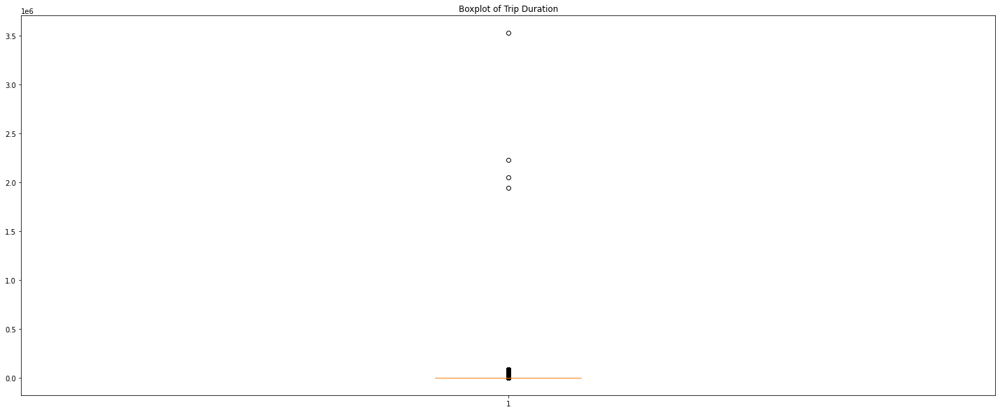

In [10]:
fig, ax = plt.subplots(figsize=(25,10))
plt.boxplot(train['trip_duration'])
plt.title('Boxplot of Trip Duration')
plt.show()

The boxplot visualization shows that 4 trip have a duration higher than 2*1e6 seconds which is at least 2 millions seconds which means those trip duration were at least 555 hours. It seems impossible and those values are out liers we need to filter out.

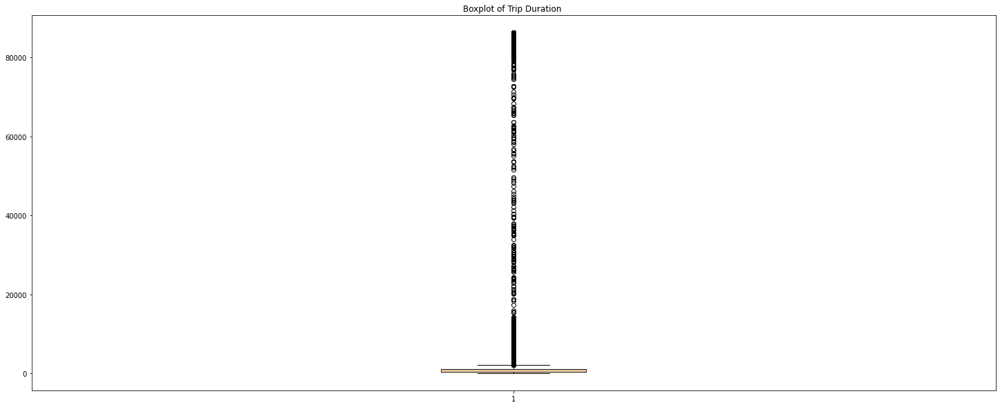

In [11]:
train_filtered = train[train['trip_duration']<1000000] 
fig, ax = plt.subplots(figsize=(25,10))
plt.boxplot(train_filtered['trip_duration'])
plt.title('Boxplot of Trip Duration outliers removed')
plt.show()

It is better but we still have many trip that last for more than 10 000 seconds which means approximatively 3 hours. Let's try again but keeping only records less than 3 hours.

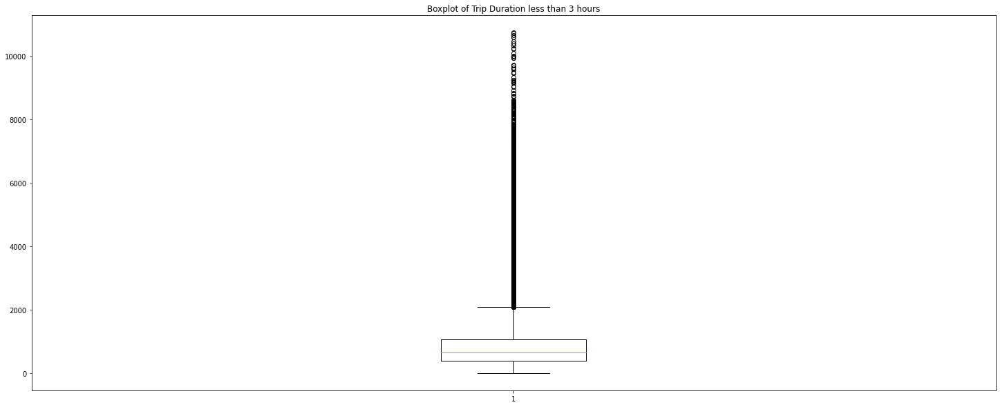

In [12]:
train_filtered_V2 = train[train['trip_duration']<=10800] 
fig, ax = plt.subplots(figsize=(25,10))
plt.boxplot(train_filtered_V2['trip_duration'])
plt.title('Boxplot of Trip Duration less than 3 hours')
plt.show()

It looks better, we now have trip that maximum last 3 hours, let's see the distribution:

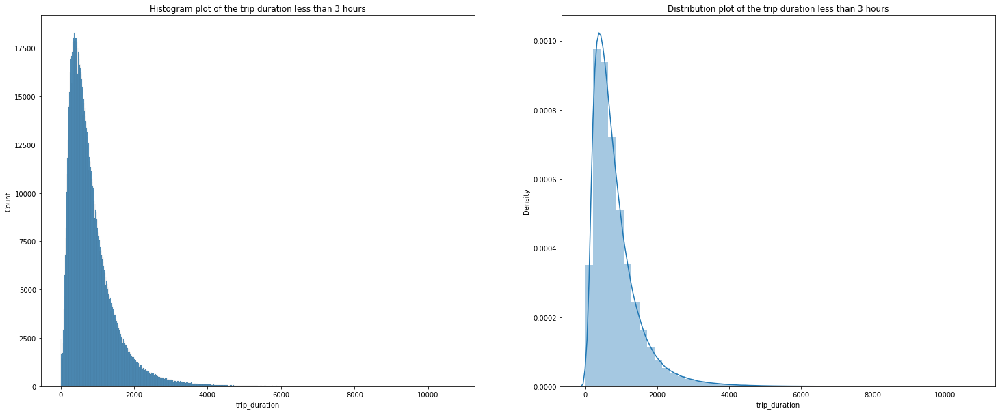

In [19]:
fig, ax = plt.subplots(1,2, figsize=(25,10))
#Histogram plot
sns.histplot(train_filtered_V2['trip_duration'], ax=ax[0])
ax[0].set_title('Histogram plot of the trip duration less than 3 hours')
#Density plot
sns.distplot(train_filtered_V2['trip_duration'], ax=ax[1])
ax[1].set_title('Distribution plot of the trip duration less than 3 hours')
plt.show()

We have some extremes values and the distribution is right skewed but this seems better. Let's try to see how the distribution would look with a log transform:

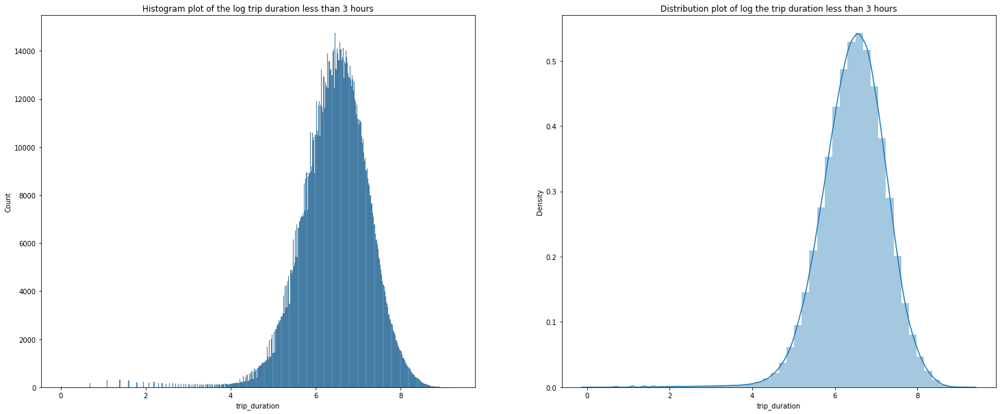

In [20]:
fig, ax = plt.subplots(1,2, figsize=(25,10))
#Histogram plot
sns.histplot(np.log(train_filtered_V2['trip_duration']), ax=ax[0])
ax[0].set_title('Histogram plot of the log trip duration less than 3 hours')
#Density plot
sns.distplot(np.log(train_filtered_V2['trip_duration']), ax=ax[1])
ax[1].set_title('Distribution plot of log the trip duration less than 3 hours')
plt.show()

The log transformation seems nice, but we might want to investigate the trip duration that are very low. Let's plot the trip that last less than 5 minutes to see if we have really low values:

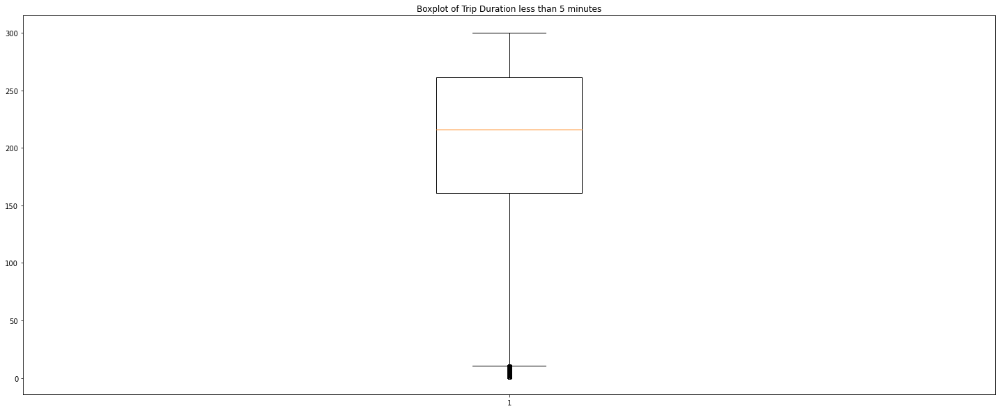

In [21]:
train_low_trip = train[train['trip_duration']<=300] 
fig, ax = plt.subplots(figsize=(25,10))
plt.boxplot(train_low_trip['trip_duration'])
plt.title('Boxplot of Trip Duration less than 5 minutes')
plt.show()

Seems that some trip duration are less than 30 secondes which doesn't seems realistic, we can assume that at least trips should last 1 minute.

We can conclude that removing trip with duration less than 1 minute and more than 3 hours seems reasonable regarding the data distribution. Also, applying a log transformation seems to let us obtain a distribution close to gaussian distribution which is appreciable. Furthermore, the metric of this Kaggle is the root mean squarred logarithmic error so it would be easier with the transformation. We will still need to encode back the log transformation of the prediction before submitting the predictions.

#### Predictors inspection:

We have for now 9 predictors before feature engineering, let's analyze them one by one:

Vendor_id:

In [25]:
#Count of all possible values
train.vendor_id.value_counts()

2    780302
1    678342
Name: vendor_id, dtype: int64

We have two different vendor id, let's see if there is a difference in trip duration between these two:

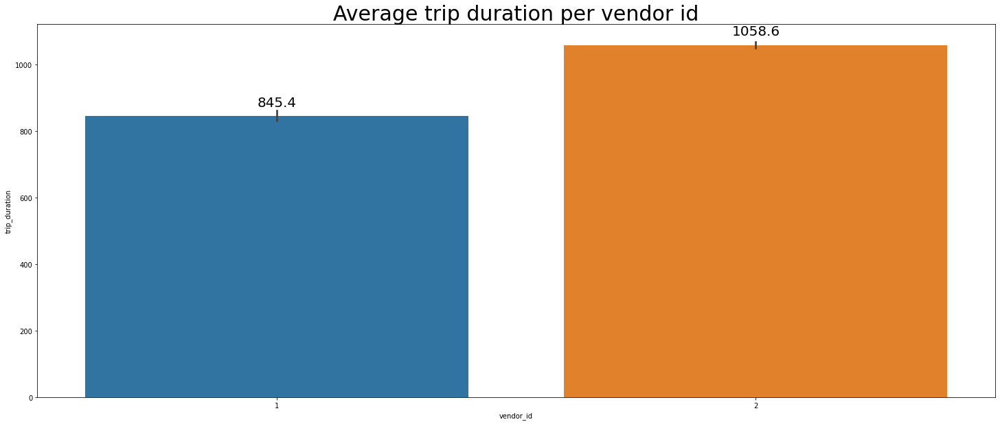

In [33]:
fig, ax = plt.subplots(figsize=(25,10))
plot = sns.barplot("vendor_id", "trip_duration", data = train)
for p in plot.patches:
    plot.annotate(format(p.get_height(), '.1f'),
                        (p.get_x() + p.get_width() / 2., p.get_height()),
                         ha = 'center', va = 'center', xytext = (0,20),
                         textcoords = 'offset points', fontsize = 20)
plt.title('Average trip duration per vendor id', fontsize = 30)
plt.show()

Pretty interesting to see that the vendor id 2 seems to have trip that last longer than the vendor 1. Let's check if it is due to a random factor:

In [35]:
#Create two arrays with values of trip_duration for each vendor_id
vendor_1 = train.loc[train['vendor_id'] ==1, 'trip_duration'].values
vendor_2 = train.loc[train['vendor_id'] ==2, 'trip_duration'].values

In [40]:
print("Pvalue =",stats.ttest_ind(vendor_1,vendor_2, equal_var = False).pvalue)

Pvalue = 1.1884201429407306e-126


The Pvalue is way less than 0.05, there is a significant difference in trip duration between the two vendor meaning that this variable contains information and the vendor 2 will have trip that last longer than the vendor 1.

Pickup_datetime:

In [47]:
#Convert to date time and print the different months of data of the pickup datetime of year 2016
pd.to_datetime(train['pickup_datetime']).dt.month.unique()

array([3, 6, 1, 4, 5, 2])

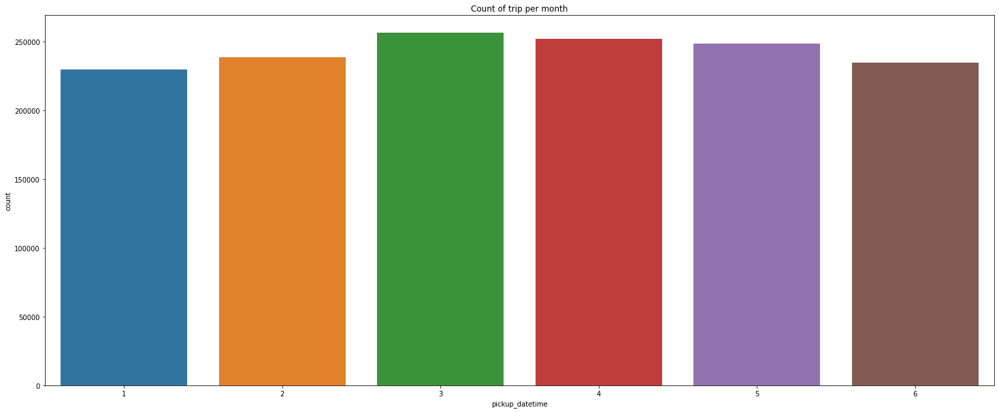

In [49]:
fig, ax = plt.subplots(figsize=(25,10))
sns.countplot(pd.to_datetime(train['pickup_datetime']).dt.month)
plt.title('Count of trip per month')
plt.show()

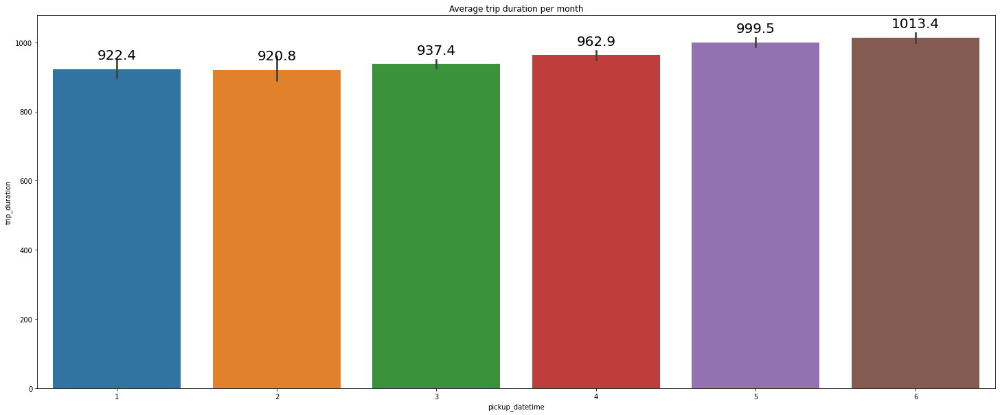

In [52]:
#Plot the average duration per month
fig, ax = plt.subplots(figsize=(25,10))
plot = sns.barplot(pd.to_datetime(train['pickup_datetime']).dt.month, train.trip_duration)
for p in plot.patches:
    plot.annotate(format(p.get_height(), '.1f'),
                        (p.get_x() + p.get_width() / 2., p.get_height()),
                         ha = 'center', va = 'center', xytext = (0,20),
                         textcoords = 'offset points', fontsize = 20)
plt.title('Average trip duration per month')
plt.show()

We can identify 3 groups within month with trip duration which are different. The first one is Jan, Feb, March, the second one is April and the third one is May / June. We will create variable to encode the month regarding those groups. Let's see if there is some pattern in the weekday of pickup date.

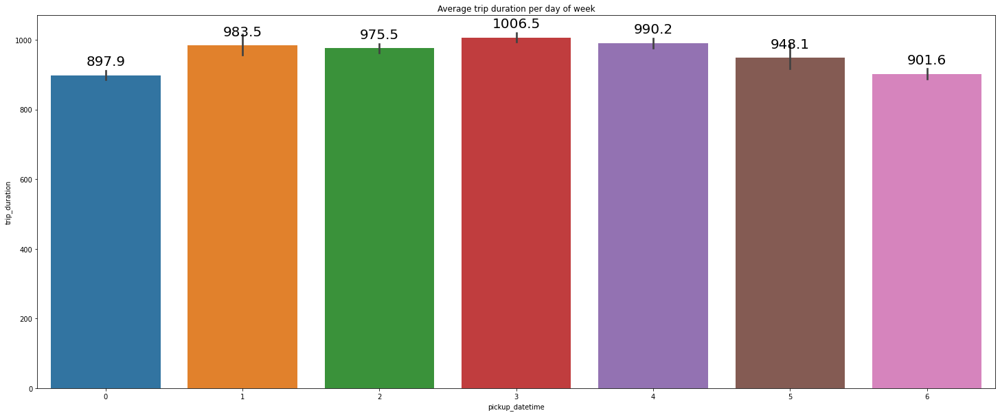

In [54]:
#Plot the average duration per weekday
fig, ax = plt.subplots(figsize=(25,10))
plot = sns.barplot(pd.to_datetime(train['pickup_datetime']).dt.weekday, train.trip_duration)
for p in plot.patches:
    plot.annotate(format(p.get_height(), '.1f'),
                        (p.get_x() + p.get_width() / 2., p.get_height()),
                         ha = 'center', va = 'center', xytext = (0,20),
                         textcoords = 'offset points', fontsize = 20)
plt.title('Average trip duration per day of week')
plt.show()

We can one more time identify 3 groups (with 0 = Monday and 6 = Sunday), the first one is Monday and Sunday, the second one is Tuesday, Wednesday, Thursday and the third one is friday. We will encode them this way. Let's finally analyze the trip duration per hour.

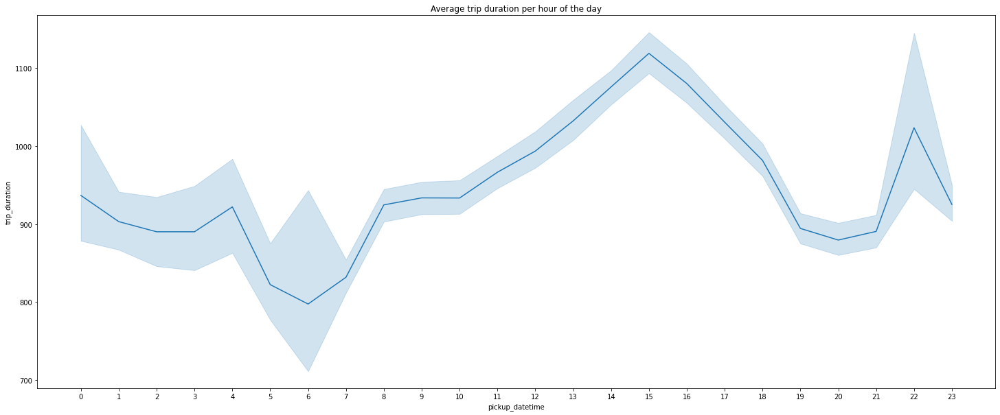

In [56]:
#Plot the average duration per hour of the day
fig, ax = plt.subplots(figsize=(25,10))
plot = sns.lineplot(pd.to_datetime(train['pickup_datetime']).dt.hour, train.trip_duration)
plot.set_xticks(range(24))
plt.title('Average trip duration per hour of the day')
plt.show()

The hour of the day as indeed an effect on the trip duration, we can see that some groupes are identifiable. 0, 1, 2, 3, 4, 9, 10, 19, 20, 21, 23 have a similar average time. A second group is between 5 and 7 which are the lowest trip duration. A third one is 11, 12, 13, 16, 17, 18, 22. A fourth one which represents high trip duration is 14, 15, 16. And thus, wr have four group to represent pick up hour of the day.

Dropoff_datetime:

We won't use the dropoff_datetime as it is non a predictor as we can't have it before ending the trip so the timeline doesn't fit (and we don' thave this information obviously in the test set).

Passenger_count:

This variable means the number of passengers in the vehicle (driver entered value).

In [58]:
train.passenger_count.value_counts()

1    1033540
2     210318
5      78088
3      59896
6      48333
4      28404
0         60
7          3
9          1
8          1
Name: passenger_count, dtype: int64

Seems like 0,7,8,9 passengers doesn't seems possible and more related ti mistakes as they are user entered values. We can identify 1-3 passengers in cars which should corresponds to car where 4-6 corresponds to vans.

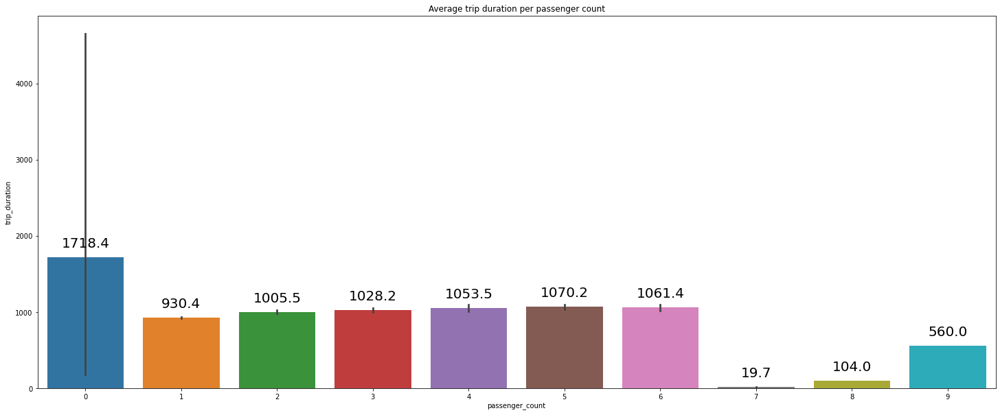

In [12]:
#Plot the average duration per weekday
fig, ax = plt.subplots(figsize=(25,10))
plot = sns.barplot(train.passenger_count, train.trip_duration)
for p in plot.patches:
    plot.annotate(format(p.get_height(), '.1f'),
                        (p.get_x() + p.get_width() / 2., p.get_height()),
                            ha = 'center', va = 'center', xytext = (0,20),
                            textcoords = 'offset points', fontsize = 20)
plt.title('Average trip duration per passenger count')
plt.show()

Without taking into account the 0, 7, 8, 9 passengers, we can identify 3 groups. Single passenger trip seems faster, then we can group 2 and 3 passengers which are cars related anf finally 4 to 6 passengers which are vans trips related.

Pickup_longitude & Pickup_latitude:

In [23]:
# fig, ax = plt.subplots(figsize=(25,10))
# ax.scatter(train.pickup_longitude.ubnique(), train.pickup_latitude.unique())
# plt.xlabel('Longitude')
# plt.ylabel('Latitude')
# plt.title('Average trip duration per passenger count')
# plt.show()

In [4]:
BBox = ((train.pickup_longitude.min(),   train.pickup_longitude.max(),
         train.pickup_latitude.min(), train.pickup_latitude.max()))
BBox

(-121.93334197998048,
 -61.33552932739258,
 34.359695434570305,
 51.88108444213867)

Seems we have some outliers location that are really far, let's plot only the values between -80 / -70 for longitude and 37.5 / 45.0 for latitude:

In [18]:
train_location = train[(train['pickup_longitude'] >= - 80) & (train['pickup_longitude'] <= -70)]
train_location = train[(train['pickup_latitude'] >= 37.5) & (train['pickup_latitude'] <= 45)]

In [6]:
map_NYC = plt.imread('/Users/spavot/Documents/Perso/Data Science /GitHub/Kaggle New York City Taxi Trip Duration/Data/map.jpg')

In [16]:
BBox = ((train_location.pickup_longitude.min(),   train_location.pickup_longitude.max(),
         train_location.pickup_latitude.min(), train_location.pickup_latitude.max()))
print(BBox)

train_location = train_location.sample(10000, random_state = 1)

(-79.56973266601562, -61.33552932739258, 37.77777099609375, 44.37194442749024)


In [3]:
# fig, ax = plt.subplots(figsize = (25,10))
# ax.scatter(train_location.pickup_longitude, train_location.pickup_latitude, zorder=1, alpha= 0.2, c='b', s=10)
# ax.set_title('Plotting Spatial Data on Riyadh Map')
# ax.set_xlim(BBox[0],BBox[1])
# ax.set_ylim(BBox[2],BBox[3])
# ax.imshow(map_NYC, zorder=0, extent = BBox, aspect= 'equal')

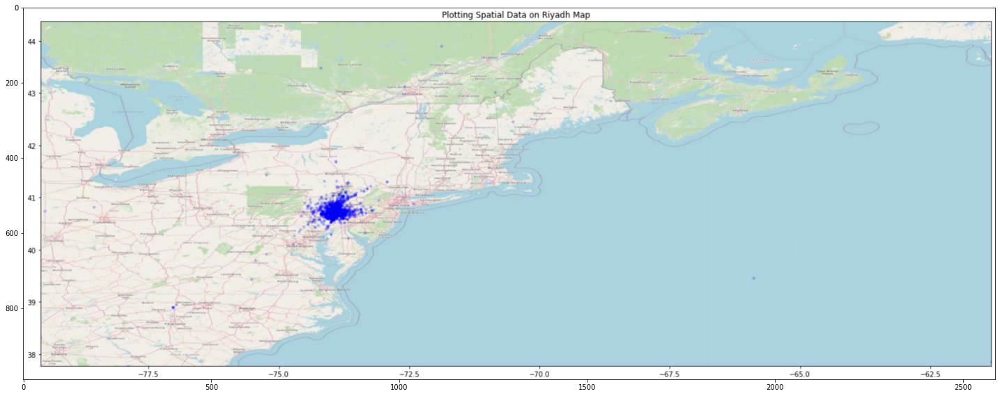

In [5]:
#We do not run the above code as it is very costly for memory and just load the map we plotted once:
fig, ax = plt.subplots(figsize=(25,10))
map_plot = plt.imread('/Users/spavot/Documents/Perso/Data Science /GitHub/Kaggle New York City Taxi Trip Duration/Data/Map Plot.png')
plt.imshow(map_plot)
plt.show()

We have some points really far from NYC, also we even have some in the ocean (guess there is no ship taxi for now) so we will remove them. We will keep only pickup_location between -75.0 / -73.0 for longitude and 40.0 / 41.5 for latitude. We will do the same for the dropoff location as we want only to focus on the NYC trips. 